# Who's fibbing? A Machine Learning Approach to Acoustic Feature Analysis

# 1 Author

**Name**: Rashad Malik



# 2 Problem formulation

The goal of this project is to develop a **machine learning model** capable of distinguishing between true and deceptive narratives based on audio recordings of spoken stories.

This task is both intriguing and challenging because it requires exploring subtle acoustic features, such as pauses and pitch variability, to try and infer the truthfulness of speech, which is a task that people often struggle with in all aspects of life.

The ability to automate this process has significant potential applications across multiple areas:

- **Law enforcement and the legal system** would greatly benefit from being able to reliably detect true or false statements.

-  **Psychological research** and academia may also benefit, where accurately assessing the veracity of statements can be critical.

However, there are also ethical concerns if a successful tool like this could fall into the hand of bad actors. There is a risk of privacy invasion if people did not consent to having their statements validated, and there could be negative psychological impacts from the misuse of such a tool. The social implications of such a project must be constantly assessed and always kept in the back of our minds.

Beyond the practical implications, this problem intersects fields like computational linguistics, acoustic analysis, and behavioural science, offering an opportunity to explore how deception manifests in human speech patterns and whether these cues can be quantified effectively for predictive purposes.

Additionally, this project was used as an opportunity to learn additional computer science tools:
- Learning to use an IDE (VSCode) to write Jupyter notebooks.
- Using Git and Github to track project progress and to host it online.

# 3. Methodology

The methodology for this project involves several stages to develop and evaluate a machine learning model capable of classifying spoken narratives as true or deceptive. The approach includes training with validation, and testing phases.

## 3.1 Training Task
The training task involved preparing predictive models based on features extracted from 30-second audio chunks, with each chunk labelled as either part of a true or deceptive story, corresponding to the original audio file's label. The dataset was first divided into an **80:20 split** for training and testing. Within the training set, **Group-K-Fold cross-validation** was performed to ensure all chunks from the same audio file were grouped together in a fold, preventing data leakage. This cross-validation process was used to determine the best-performing model based on **accuracy**, while avoiding overfitting to specific speech patterns. Predictors include features such as the number of pauses, total silence duration, pause-to-speech ratio, pitch range, and pitch variability, extracted from the audio samples.

## 3.2 Test Task
Once the best-performing model was identified during cross-validation, it was retrained using the **entire training set** with the optimal hyperparameters. The final evaluation was conducted on the unseen test set, ensuring a fair assessment of the model's generalisation ability. The performance on the test set provided the final results for accuracy and other metrics.

## 3.3 Model Performance Definition
Model performance is evaluated using multiple metrics. **Accuracy** serves as the primary measure, providing a simple baseline for overall model correctness, and for comparing models during training and validation. After the best-performing model was selected, the **F1-score** was used for a balanced evaluation between precision and recall, which is particularly important in the presence of class imbalances. Additionally, the **confusion matrix** was analysed to identify patterns of misclassification, such as false positives (incorrectly predicting deceptive stories as true) and false negatives (failing to detect deceptive stories).

## 3.4 Other Tasks
Several preparatory steps were undertaken to build the model effectively. Audio data was preprocessed to standardise sampling rates and normalise amplitudes, ensuring consistent input. **Feature engineering** was carried out to extract meaningful acoustic features from each audio chunk. Exploratory data analysis helped us better design the extraction of some features such as silent regions within the audio. Finally, **hyperparameter tuning** was conducted during the cross-validation phase to optimise model performance, resulting in better generalisation to unseen data. This multi-step methodology helped ensure that the models were trained effectively and evaluated rigorously.

# 4 Implemented ML prediction pipelines

The implemented machine learning prediction pipeline processes audio data to classify spoken stories as **either true or deceptive**. The pipeline begins by normalising the extracted acoustic features, such as pauses, silence durations, and pitch variability, to ensure consistency across all input data.

Three machine learning models were explored:

- Logistic regression

- Support Vector Machines (SVM)

- k-Nearest Neighbors (k-NN)

Each model was tuned using **GridSearchCV with GroupKFold cross-validation** to prevent data leakage and identify the optimal hyperparameters. The best-performing model, an SVM with an RBF kernel, was selected based on cross-validation accuracy and subsequently evaluated on a separate test set to assess its generalisation performance. The pipeline ensures a systematic approach to feature preparation, model training, and evaluation.

## 4.1 Transformation Stage

The **transformation stage** of the pipeline focuses on two main areas: the **preprocessing** stage, and the **feature extraction** stage to prepare the raw audio data for the machine learning models. The input to this stage consists of **30-second chunks of audio data**, sampled at a uniform rate. The output is a set of **numerical features** that capture key acoustic characteristics of the audio, including the **number of pauses**, **total silence duration**, **pause-to-speech ratio**, **pitch range**, and **pitch variability**.

According to Rockwell, Buller, and Burgoon (1997), deceivers may **exhibit increased pitch variety**, potentially as a strategy to appear more truthful and expressive. Loy, Rohde, and Corley (2018) found an **increase in filled pauses when lying**, especially for complex lies that require greater cognitive effort to fabricate. These are the main factors which contributed to our feature selection. Additionally, studies also pointed towards **speech rate or tempo** being another big factor which indicates deception, however, this is a more complicated feature to extract. Due to time constraints, it will not be included in this project.

**Language** is another key feature that could help our models with their classification, as different languages have distinct speech patterns. However, our project's dataset is heavily skewed towards English speakers (78 out of the total 100 audio files are in English), and we will not use Language as an extracted feature. In future work, this would be a useful feature to explore, and to understand how it impacts our models.

After feature extraction, the data is **normalised** using **StandardScaler** to standardise the feature distributions, ensuring that all predictors are on a consistent scale. This step is particularly crucial for machine learning models like **SVM** and **k-NN**, which are sensitive to feature magnitudes. The transformation stage ensures that the data is both **interpretable** and **compatible** with the machine learning models, enabling effective training and evaluation. By focusing on these specific features, the pipeline emphasises **interpretability** while leveraging **acoustic properties** relevant to the challenge of distinguishing **true** from **deceptive stories**.

## 4.2 Model stage

The machine learning models implemented for this project are Support Vector Machines (SVM), Logistic Regression, and k-Nearest Neighbors (k-NN). These models were selected for their complementary strengths, their ability to handle the relatively small dataset and numerical features extracted from the audio data, and their ease of use due to their availability in the scikit-learn library.

### 4.2.1 Logistic Regression
[Logistic Regression](https://www.datacamp.com/tutorial/understanding-logistic-regression-python) was included as a baseline model due to its simplicity, interpretability, and availability in scikit-learn. It assumes a linear relationship between the input features and the target variable, which provides a useful benchmark for evaluating the complexity of the problem. Its straightforward implementation allowed for rapid prototyping and ensured that initial results could be obtained quickly, saving time for more complex analyses.

### 4.2.2 Support Vector Machines (SVM)
[SVM](https://scikit-learn.org/stable/modules/svm.html) was chosen due to its effectiveness in handling non-linear relationships through the use of kernels, such as the radial basis function (RBF) kernel. Given the complexity of audio-derived features and the possibility of non-linear decision boundaries between true and deceptive stories, SVM provides a robust framework for classification. It also performs well in high-dimensional spaces, which is beneficial for handling the multiple acoustic features extracted in this project.

### 4.2.3 k-Nearest Neighbors (k-NN)
[k-NN](https://www.datacamp.com/tutorial/k-nearest-neighbor-classification-scikit-learn) was selected for its simplicity and ability to model local relationships in the data. As a non-parametric method, k-NN relies on the proximity of data points in feature space, which may be advantageous when working with small datasets and features like pauses and pitch variability that capture local variations. Its implementation in scikit-learn made it easy to test and tune hyperparameters such as the number of neighbors and distance metric, enabling efficient experimentation without unnecessary complexity.

### 4.2.4 Ease of Implementation
One of the primary reasons these models were chosen was their accessibility through the scikit-learn library, which offers straightforward implementations of these algorithms with consistent syntax and extensive documentation. This reduced the time required for setting up and running experiments, allowing for a focus on feature engineering, evaluation, and hyperparameter tuning. Given the nearing project deadline, this ease of use was a critical factor in selecting models that could be implemented and evaluated efficiently, without introducing undue complexity.

These models provide a balance of robustness, simplicity, and practicality, ensuring that meaningful results could be obtained within the constraints of the project timeline. Through cross-validation and hyperparameter tuning, the best-performing model (SVM) was identified, reflecting its suitability for capturing the underlying structure of the data.

## 4.3 Ensemble stage

For this project, an ensemble approach was not implemented due to time constraints and the focus on building and evaluating individual models (SVM, Logistic Regression, and k-NN). Each of these models was trained and optimised independently, and the best-performing model (SVM) was selected based on cross-validation results for evaluation on the test set.

Although ensembles were not included in the current implementation, they present a valuable future avenue for exploration. [Ensemble methods](https://futuremachinelearning.org/ensemble-learning-techniques-applications-and-benefits/), such as **voting classifiers**, **bagging** (e.g., Random Forest), or **boosting** (e.g., Gradient Boosting, AdaBoost), could potentially improve the overall performance by combining the strengths of individual models. For example:
- **Soft Voting Ensembles** could combine the probabilistic outputs of SVM, Logistic Regression, and k-NN to create a more robust classifier.
- **Stacking Ensembles** could use a meta-model, such as Logistic Regression, to learn how to best combine the predictions of the base models.

Ensemble methods are particularly useful in scenarios where individual models capture different aspects of the data and their errors are uncorrelated. By combining their predictions, ensembles can often achieve higher accuracy and robustness than any single model.

# 5 Dataset

For this project, we are using data from the **MLEnd Small Deception dataset**. This dataset, created by the Data Science and AI Teaching Group at Queen Mary University of London, is a collection of 100 audio files. Each audio file roughly ranges from 2 to 4 minutes in length, and contains a story narrated by a student or faculty member at the University. The stories can either be true stories, or deceptive (made up).

In addition to the 100 audio files, the dataset also includes a CSV file which contains the *Language* and *Story Type* (whether the story was truthful or deceptive) for each audio file.

## 5.1 MLEnd library setup and data download

In [1]:
# Showing that the MLEnd library is installed on our system
!pip show mlend

# If you have not got the library installed, uncomment out the line below (ensure it is version 1.0.0.4)
# !pip install mlend==1.0.0.4

Name: mlend
Version: 1.0.0.4
Summary: MLEnd Datasets
Home-page: https://MLEndDatasets.github.io
Author: Jesús Requena Carrión and Nikesh Bajaj
Author-email: nikkeshbajaj@gmail.com
License: MIT
Location: c:\programdata\anaconda3\envs\py310\lib\site-packages
Requires: joblib, matplotlib, numpy, pandas, scipy, spkit
Required-by: 


Now, we will import the library along with some key functions, and download the dataset.

> **Note**: The dowloaded dataset requires approximately 1.8GB of available disc space.

In [2]:
# Importing the MLEnd library and functions
import mlend
from mlend import download_deception_small, deception_small_load

In [3]:
# Downloading the "small" deception dataset
datadir = download_deception_small(save_to='MLEnd', subset={}, verbose=1, overwrite=False)

100%|▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓▓|100\100|00100.wav
Done!


## 5.2 Preliminary data exploration

We will now explore our downloaded files to understand the dataset a bit further before beginning our experimentation.

In [4]:
import glob

# Checking how many audio files we have
sample_path = r'MLEnd\deception\MLEndDD_stories_small\*.wav'
files = glob.glob(sample_path)
print("Number of downloaded audio files:",len(files))

Number of downloaded audio files: 100


Shortest audio file duration (in seconds): 43.4
Longest audio file duration (in seconds): 247.6


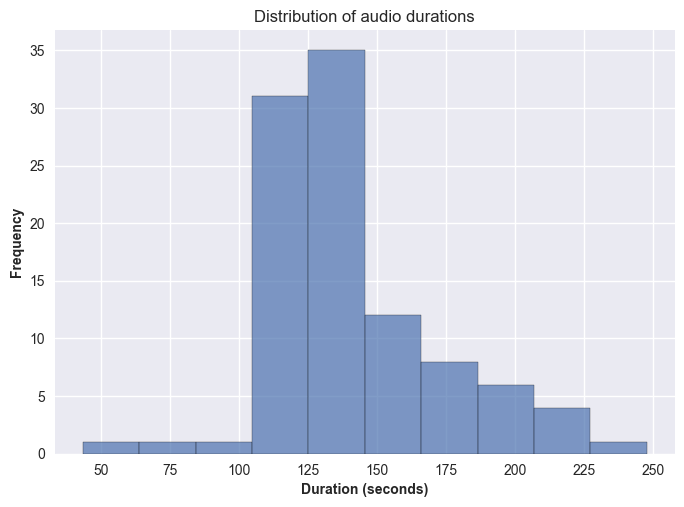

In [5]:
import librosa
import matplotlib.pyplot as plt
import matplotlib.style as style

# Finding the ranges of durations for our audio files
durations = []
for i in range(len(files)):
    fs = None
    x, fs = librosa.load(files[i],sr=fs)
    duration = librosa.get_duration(y=x, sr=fs)
    durations.append(duration)

print("Shortest audio file duration (in seconds):", round(min(durations),1))
print("Longest audio file duration (in seconds):", round(max(durations),1))

# Plotting the distribution of durations
style.use("seaborn-v0_8")
plt.hist(durations, bins=10, edgecolor="black", alpha=0.7)
plt.title("Distribution of audio durations", fontsize = 12)
plt.xlabel("Duration (seconds)", fontsize = 10, fontweight = "bold")
plt.ylabel("Frequency", fontsize = 10, fontweight = "bold")
plt.show()

We can see that most audio files are around 110 to 150 seconds long, and there is a wide distribution of durations, ranging from as low as 43 seconds to 248 seconds. We will need to keep this in mind when we eventually start experimenting with these files.

We will now import the CSV file into a Pandas dataframe, and use it to describe the distribution of languages and story types.

In [6]:
import pandas as pd

# Loading the CSV file into a Pandas dataframe
MLEND_df = pd.read_csv(r'MLEnd\deception\MLEndDD_story_attributes_small.csv')
language_counts = MLEND_df["Language"].value_counts()
story_type_counts = MLEND_df["Story_type"].value_counts()

display(MLEND_df)
display(language_counts)
print("Number of unique languages in the dataset:", len(MLEND_df["Language"].unique()))
display(story_type_counts)


,filename,Language,Story_type
0,00001.wav,Hindi,deceptive_story
1,00002.wav,English,true_story
2,00003.wav,English,deceptive_story
3,00004.wav,Bengali,deceptive_story
4,00005.wav,English,deceptive_story
...,...,...,...
95,00096.wav,English,deceptive_story
96,00097.wav,English,true_story
97,00098.wav,English,deceptive_story
98,00099.wav,English,true_story


Language
English              78
Hindi                 4
Arabic                3
Chinese, Mandarin     2
Marathi               2
Bengali               1
Kannada               1
French                1
Russian               1
Portuguese            1
Spanish               1
Swahilli              1
Telugu                1
Korean                1
Cantonese             1
Italian               1
Name: count, dtype: int64

Number of unique languages in the dataset: 16


Story_type
deceptive_story    50
true_story         50
Name: count, dtype: int64

There are 16 unique languages in the dataset, with English being the most commonly spoken (with 78 audo files). Additionally, we have an even split of story types, with both true and deceptive stories each making up half of the dataset.

## 5.3 Data preparation and training/test data split

### 5.3.1 Creating 30 second chunks

In this project, we are specifically required to build a machine learning model that takes a **30 second** audio clip, and to predict whether the story being narrated is **true or not**.

However, as seen in section 5.2, the duration of our audio files are varied. Therefore, we will need to initially need to split all of our audio files into **30 second chunks**, in order to ensure data consistency, and computational efficiency. This will help us strike a balance between retaining meaningful context and making the data manageable for both feature extraction and our machine learning models.

This raises a new challenge. As our audio files are **not perfectly divisible** by 30 seconds, we must decide on an approach that allows us to divide all files into 30 second chunks. The approach we will use for this project is as follows:

1. Round down the audio length to the nearest number divisible by 30.

2. Subtract this number from the original length of the audio.

3. Divide this number by two, and trim the start and end by this amount.

Let us demonstrate this approach practically:

In [7]:
import IPython.display as ipd

# Function to trim audio evenly from the start and tail
def trim_audio_equal(audio_file):
    fs = None
    x, fs = librosa.load(audio_file,sr=fs)
    total_duration = librosa.get_duration(y=x, sr=fs)

    # Calculate the excess audio duration
    excess_duration = total_duration % 30
        
    # Trimming half of the excess from start and half from end
    trim_amount = int((excess_duration / 2) * fs)
    total_trimmed = (trim_amount * 2) / fs

    # Trim the audio
    trimmed_audio = x[trim_amount : -trim_amount]

    return trimmed_audio, total_trimmed, fs, x

file_number = 1
trimmed_audio, amount, fs, x = trim_audio_equal(files[file_number - 1])
print("Original audio from file number " + str(file_number) + ":")
display(ipd.Audio(x, rate=fs))
print("File number", file_number, "has successfully been trimmed.\n",
      round(amount, 2), "seconds removed.")
display(ipd.Audio(trimmed_audio, rate=fs))

Original audio from file number 1:


File number 1 has successfully been trimmed.
 2.17 seconds removed.


We can see that the audio file was initially 122.17 seconds, and our function successfully trimmed the additional 2.17 seconds evenly from the start and end of the audio file. We can then divide the audio file into consistently sized 30 second chunks. There are a few advantages of this approach:

- Trimming ensures all chunks are exactly 30 seconds long, avoiding leftover segments at the start or end of the file.

- By evenly trimming from both ends, we try to prevent introducing bias. Had we only trimmed the end for example, we might miss out on key information related to narratives at the end of the stories.

- We avoid artificially padding the data with silence or noise to make up for missing time, which could have skewed features and given a misrepresentation of our classes.

- It is more computationally efficient to discard the excess data, and for the limited length of time available on this project, it is a quick approach.

The trimming approach, while ensuring uniform chunk sizes, does have some drawbacks. There is a **risk of losing potentially valuable information**, such as introductory or concluding speech patterns, which might contain important cues for deception detection. Additionally, this method assumes that the removed segments are not critical to the classification task, which may not always hold true. We need to keep this in mind when moving forward with our analysis.

We will now create a new dataframe with the audio samples divided into chunks:

In [8]:
# Function to divide audio into 30 second chunks
def divide_audio_chunks(audio, fs):
    chunk_size = fs * 30
    total_chunks = len(audio) // chunk_size
    chunks = []

    for i in range(total_chunks):
        start = i * chunk_size
        end = (i + 1) * chunk_size
        chunks.append(audio[start:end])
    
    return chunks

# Looping through all the audio files, trimming and dividing them into 30 second chunks
MLEND_chunks = pd.DataFrame(columns=["filename", "chunk_number", "language", "Story_type", "samples"])
trimmed_list = []

for i in range(len(files)):
    trimmed_audio, _, fs, _ = trim_audio_equal(files[i])
    chunks = divide_audio_chunks(trimmed_audio, fs)
    filename = MLEND_df["filename"].iloc[i]
    language = MLEND_df["Language"].iloc[i]
    story_type = MLEND_df["Story_type"].iloc[i]
    for chunk in range(len(chunks)):
        trimmed = {
            "filename": filename,
            "chunk_number": (chunk + 1),
            "language": language,
            "Story_type": story_type,
            "samples": chunks[chunk]
        }
        trimmed_list.append(trimmed)
    
MLEND_chunks = pd.concat([MLEND_chunks, pd.DataFrame(trimmed_list)], ignore_index=True)
display(MLEND_chunks.head())

,filename,chunk_number,language,Story_type,samples
0,00001.wav,1,Hindi,deceptive_story,"[-0.006515503, -0.00680542, -0.006958008, -0.0..."
1,00001.wav,2,Hindi,deceptive_story,"[0.022506714, 0.023269653, 0.023925781, 0.0247..."
2,00001.wav,3,Hindi,deceptive_story,"[0.0006713867, 0.00064086914, 0.0005493164, 0...."
3,00001.wav,4,Hindi,deceptive_story,"[-0.0009460449, -0.0031738281, -0.0043792725, ..."
4,00002.wav,1,English,true_story,"[-0.009094238, -0.00982666, -0.010406494, -0.0..."


We have successfully divided the data into 30 second chunks. Additionally, we have maintained the filename of each chunk, which is crucial for when we eventually split our data into training and testing sets, in order to ensure that when our data is drawn randomly, it still **maintains its independence**. This will allow us to keep the test dataset completely separate which will help us get an **estimate of the true deployment quality** of our models.

### 5.3.2 Selecting samples for our training and test sets

We will now create our **training** and **test** datasets. By tracking the filename of each audio chunk, we can draw the data randomly and independently from our file list, to ensure they are IID (independent and identically distributed). We will do a **stratified split** of our data, using the `Story_type` attribute to determine the split. This is in order to ensure our training and test sets have equal proportions of true and deceptive stories, thus being more representative of the overall dataset.

> **Note**: We are using a random seed of `8` to maintain reproducibility for documenting our findings.

In [9]:
from sklearn.model_selection import train_test_split

# Stratified split 
files_train, files_test = train_test_split(
    MLEND_df["filename"],
    test_size=0.2,
    stratify=MLEND_df["Story_type"],
    random_state=8
)

# Filter MLEND_df for training and test files
train_data = MLEND_df[MLEND_df['filename'].isin(files_train)]
test_data = MLEND_df[MLEND_df['filename'].isin(files_test)]

# Count the occurrences of each story type for training set
train_story_counts = train_data["Story_type"].value_counts()
print("Training Set:")
print("Number of true stories:", train_story_counts.get('true_story', 0))
print("Number of deceptive stories:", train_story_counts.get('deceptive_story', 0))

# Count the occurrences of each story type for test set
test_story_counts = test_data["Story_type"].value_counts()
print("\nTest Set:")
print("Number of true stories:", test_story_counts.get('true_story', 0))
print("Number of deceptive stories:", test_story_counts.get('deceptive_story', 0))

Training Set:
Number of true stories: 40
Number of deceptive stories: 40

Test Set:
Number of true stories: 10
Number of deceptive stories: 10


We have successfully split the training and test dataset proportionally with respect to the number of true and deceptive stories.

While this approach ensures that the training and test sets are independent, a key **limitation** lies in the assumption that chunks from the same file do not share critical dependencies, which may oversimplify the relationships in the data. Additionally, the relatively small size of the dataset may limit the generalisability of the models to unseen data. Despite these limitations, this splitting strategy should hopefully be appropriate for reducing bias and ensuring robust model performance.

## 5.4 Feature extraction

As mentioned in section 4, the features that we decided to extract are the following:

- **Pauses**
    - Number of pauses
    - Total duration of silence
    - Pause-to-speech ratio

- **Pitch variety**
    - Pitch range
    - Pitch variability (standard deviation)

We will need to define functions to extract these features. Starting with pauses, we must define silent regions in speech:

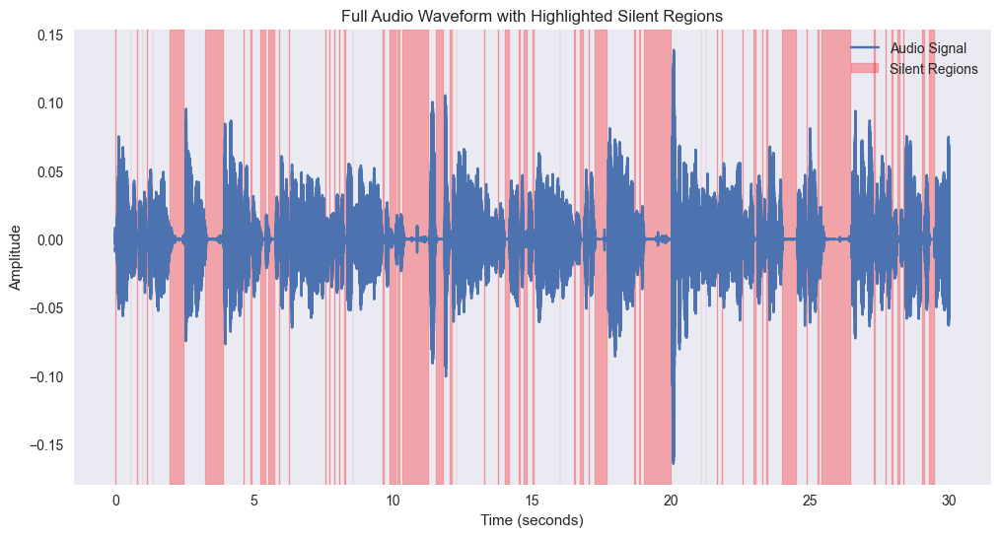

In [10]:
import numpy as np

# Frame based RMS calculation for silence
def detect_silence(audio, sr, frame_length=4096, hop_length=256, silence_threshold=0.005):
    
    # Compute RMS for each frame
    rms = librosa.feature.rms(y=audio, frame_length=frame_length, hop_length=hop_length)[0]
    silent_frames = rms < silence_threshold
    times = librosa.frames_to_time(range(len(silent_frames)), sr=sr, hop_length=hop_length)
    
    # Identify silent regions
    silent_regions = []
    start_time = None
    for i, is_silent in enumerate(silent_frames):
        if is_silent and start_time is None:
            start_time = times[i]
        elif not is_silent and start_time is not None:
            end_time = times[i]
            silent_regions.append((start_time, end_time))
            start_time = None
    
    # Handle case where audio ends in silence
    if start_time is not None:
        silent_regions.append((start_time, times[-1]))
    
    return silent_regions

# Creating a plot to visualise silenced regions
def plot_full_audio_with_silence(audio, sr, silent_regions):
    t = np.arange(len(audio)) / sr
    
    # Plot the full waveform
    plt.figure(figsize=(12, 6))
    plt.plot(t, audio, label="Audio Signal")
    
    # Highlight each silent region
    for start_time, end_time in silent_regions:
        plt.axvspan(start_time, end_time, color="red", alpha=0.3)
    
    # Add labels and legend
    plt.xlabel("Time (seconds)")
    plt.ylabel("Amplitude")
    plt.title("Full Audio Waveform with Highlighted Silent Regions")
    plt.legend(["Audio Signal", "Silent Regions"], loc="upper right")
    plt.grid()
    plt.show()

silent_regions = detect_silence(MLEND_chunks["samples"][0], fs)
plot_full_audio_with_silence(MLEND_chunks["samples"][0], fs, silent_regions)

We can see with our currently set silence threshold of 0.005, there seems to be an excess of silent regions detected in this sample chunk. We can change this threshold to give us a better representation of silent regions in our audio.

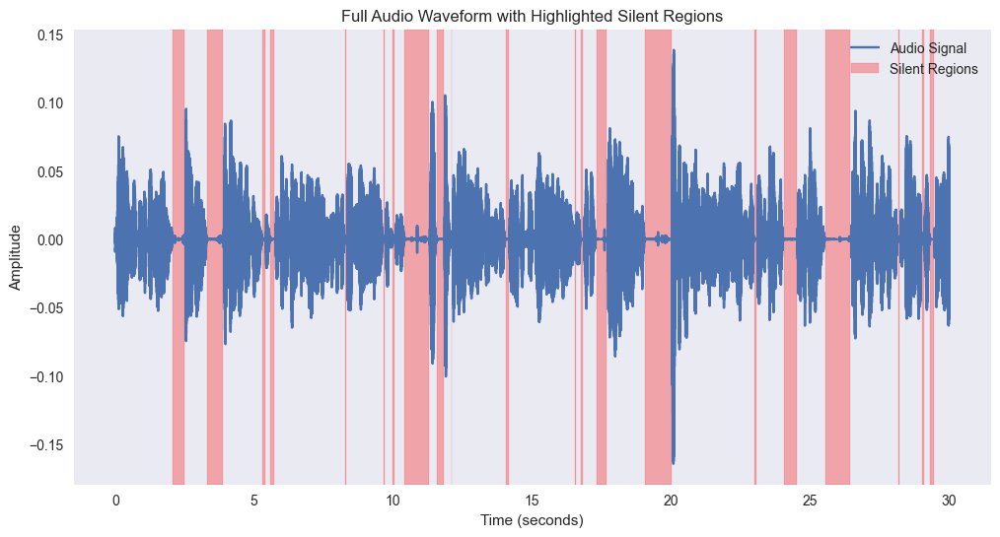

In [11]:
# Changing the silence threshold
silent_regions = detect_silence(MLEND_chunks["samples"][0], fs, silence_threshold=0.001)
plot_full_audio_with_silence(MLEND_chunks["samples"][0], fs, silent_regions)
display(ipd.Audio(MLEND_chunks["samples"][0], rate=fs))

Looking at the plot with the adjusted silence threshold, we can compare it directly with the spoken audio. The silence does match up with the speaker's pauses, so we will continue with this adjusted threshold of 0.001. We are now able to extract our pause related features:

In [12]:
# Number of pauses
num_pauses = len(silent_regions)

# Total duration of silence
total_silence_duration = sum(end - start for start, end in silent_regions)

# Pause-to-Speech Ratio
total_audio_duration = len(x) / fs
speech_duration = total_audio_duration - total_silence_duration
pause_to_speech_ratio = total_silence_duration / speech_duration

print("Number of pauses:", num_pauses)
print("Total duration of silence:", total_silence_duration)
print("Pause to speech ratio:", pause_to_speech_ratio)

Number of pauses: 21
Total duration of silence: 5.636643990929705
Pause to speech ratio: 0.04837050009729519


It is important to note however that we adjusted the silence threshold based on observing one 30 second audio sample out of out entire dataset. The speakers have recorded the audio in different environments and recording equipment, thus would have had different background noise, affecting what the threshold would be per speaker. This means that although silence detection for the above speaker and others similar to them would work well, **it does not guarantee that it would work well for other speakers**. This is an area of potential improvement for future analysis on this dataset.

For pitch variety, the librosa library can extract the fundamental frequency from an audio sample, meaning the defined function is relatively straight forward:

In [13]:
# Function that extracts pitch features of an audio sample
def getPitch(x,fs,winLen=0.02):
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, _, _ = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  cleaned_f0 = f0[~np.isnan(f0)]

  pitch_range = np.max(cleaned_f0) - np.min(cleaned_f0)
  pitch_variability_std = np.std(cleaned_f0)

  return pitch_range, pitch_variability_std

pitch_range, pitch_variability_std = getPitch(MLEND_chunks["samples"][0],fs)
print(f"Pitch Range: {pitch_range} Hz")
print(f"Pitch Variability (StdDev): {pitch_variability_std} Hz")

Pitch Range: 360.144889454402 Hz
Pitch Variability (StdDev): 36.664964416506464 Hz


We have successfully extracted the pitch variety features from our sample audio. We can now combine both functions into a main feature extraction function, and apply it to the entire dataset.

In [14]:
# Function that extracts all required features
def extract_features(samples, sr=44100):
    silent_regions = detect_silence(samples, sr)
    # Number of pauses
    num_pauses = len(silent_regions)
    # Total duration of silence
    total_silence_duration = sum(end - start for start, end in silent_regions)
    # Pause-to-Speech Ratio
    total_audio_duration = len(samples) / sr
    speech_duration = total_audio_duration - total_silence_duration
    pause_to_speech_ratio = total_silence_duration / speech_duration

    pitch_range, pitch_variability = getPitch(samples,sr,winLen=0.02)

    return [num_pauses, total_silence_duration, pause_to_speech_ratio, pitch_range, pitch_variability]

In [15]:
from tqdm import tqdm

# Function that takes the full chunk dataframe and extracts X and y arrays based on a selection
def getXy(df_full, train_selection):
    X_train, X_test, y_train, y_test, groups_train, groups_test = [], [], [], [], [], []
    
    # Iterate through rows with a progress bar
    for _, row in tqdm(df_full.iterrows(), total=len(df_full), desc="Processing rows"):
        x = row["samples"]
        yi = row["Story_type"] == "true_story"
        xi = extract_features(x)

        if row["filename"] in train_selection.values:
            # Append features and labels for training set
            X_train.append(xi)
            y_train.append(yi)
            groups_train.append(row["filename"])
        else:
            # Append features and labels for test set
            X_test.append(xi)
            y_test.append(yi)
            groups_test.append(row["filename"])

    return np.array(X_train), np.array(y_train), np.array(groups_train), np.array(X_test), np.array(y_test), np.array(groups_test)

We have finished defining the feature extraction functions, and can now extract the features for creating the training and test arrays for our machine learning models. Also notice how we defined "group" arrays as well, in order to retain the filename information for each chunk and to ensure no data leakage occurs.

> **Warning**: The next block of code can take up to an hour to run, as it is extracting the features for all 30 second audio chunks for our entire dataset. After running the cell, we recommend you save the variables to local files to prevent having to run the code again in the future.

In [16]:
# Applying the above function on our dataset
X_train, y_train, groups_train, X_test, y_test, groups_test = getXy(MLEND_chunks, files_train)

Processing rows: 100%|██████████| 420/420 [48:14<00:00,  6.89s/it]


In [ ]:
# If you would like to locally save the above variables, uncomment the lines below 
# np.save("variables/X_train.npy", X_train)
# np.save("variables/y_train.npy", y_train)
# np.save("variables/groups_train.npy", groups_train)
# np.save("variables/X_test.npy", X_test)
# np.save("variables/y_test.npy", y_test)
# np.save("variables/groups_test.npy", groups_test)

# 6 Experiments and results

Below we will prepare three models with pipelines to ensure consistent feature scaling, making them ready for training and evaluation. Standardisation was applied to all models to ensure that features are on the same scale, which is particularly important for algorithms like SVC and k-NN that are sensitive to feature magnitudes. These models were chosen for their simplicity, effectiveness in classification tasks, and complementary strengths:

- **Logistic Regression** is interpretable and fast.  
- **SVC** is robust for complex feature spaces.  
- **k-NN** is intuitive and relies on proximity-based decisions.  

The starting parameters are standard defaults or commonly used settings to provide a baseline for further optimisation.

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier

# Defining normalised models
models = {
    "Logistic Regression": Pipeline([("scaler", StandardScaler()), ("lr", LogisticRegression(max_iter=1000))]),
    "SVC": Pipeline([("scaler", StandardScaler()), ("svc", SVC(C=1.0))]),
    "k-NN": Pipeline([("scaler", StandardScaler()), ("knn", KNeighborsClassifier(n_neighbors=5))]),
}

Next, we will perform hyperparameter optimisation using **GridSearchCV** for our three machine learning models while leveraging **GroupKFold cross-validation** to ensure no data leakage between training and validation sets.

**GroupKFold** is used because the dataset contains multiple chunks per audio file, and it ensures that all chunks from the same file are assigned to the same fold, preventing related data from appearing in both training and validation sets. We will be using `5` splits for our analysis, to ensure a good balance of efficiency and exploration.

**GridSearchCV** evaluates combinations of hyperparameters (defined in the parameter grids) across the folds and computes validation metrics (e.g., **accuracy**). The best-performing hyperparameters for each model are selected based on the highest cross-validation accuracy, ensuring robust evaluation. This approach allows fair comparisons of models and guards against overfitting to specific folds.

In [ ]:
from sklearn.model_selection import GroupKFold
from sklearn.model_selection import GridSearchCV

# Define GroupKFold
group_kfold = GroupKFold(n_splits=5)

# Define parameter grids
param_grid_lr = {
    "lr__C": [0.01, 0.1, 1, 10, 100],
    "lr__penalty": ["l2"],
    "lr__solver": ["lbfgs", "saga"],
}

param_grid_svc = {
    "svc__C": [0.1, 1, 10, 100],
    "svc__kernel": ["linear", "rbf"],
    "svc__gamma": [0.1, 1, 10],
}

param_grid_knn = {
    "knn__n_neighbors": [3, 5, 7, 9, 11],
    "knn__weights": ["uniform", "distance"],
    "knn__metric": ["minkowski"],
    "knn__p": [1, 2],
}

# Perform GridSearchCV
grid_search_lr = GridSearchCV(
    estimator=models["Logistic Regression"],
    param_grid=param_grid_lr,
    cv=group_kfold.split(X_train, y_train, groups_train),
    scoring="accuracy",
    refit=True,
    verbose=0
)

svc_grid = GridSearchCV(
    estimator=models["SVC"],
    param_grid=param_grid_svc,
    cv=group_kfold.split(X_train, y_train, groups_train),
    scoring="accuracy",
    refit=True,
    verbose=0
)

grid_search_knn = GridSearchCV(
    estimator=models["k-NN"],
    param_grid=param_grid_knn,
    cv=group_kfold.split(X_train, y_train, groups_train),
    scoring="accuracy",
    refit=True,
    verbose=0
)

# Fit GridSearchCV
grid_search_lr.fit(X_train, y_train)
svc_grid.fit(X_train, y_train)
grid_search_knn.fit(X_train, y_train)

# Output concise results
print(f"Best Parameters for Logistic Regression: {grid_search_lr.best_params_}")
print(f"Best Cross-Validation Accuracy for Logistic Regression: {grid_search_lr.best_score_:.4f}")

print(f"\nBest SVC Parameters: {svc_grid.best_params_}")
print(f"Best Cross-Validation Accuracy for SVC: {svc_grid.best_score_:.4f}")

print(f"\nBest Parameters for k-NN: {grid_search_knn.best_params_}")
print(f"Best Cross-Validation Accuracy for k-NN: {grid_search_knn.best_score_:.4f}")

c:\ProgramData\anaconda3\envs\py310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge


Best Parameters for Logistic Regression: {'lr__C': 1, 'lr__penalty': 'l2', 'lr__solver': 'lbfgs'}
Best Cross-Validation Accuracy for Logistic Regression: 0.3982

Best SVC Parameters: {'svc__C': 10, 'svc__gamma': 1, 'svc__kernel': 'rbf'}
Best Cross-Validation Accuracy for SVC: 0.5190

Best Parameters for k-NN: {'knn__metric': 'minkowski', 'knn__n_neighbors': 5, 'knn__p': 1, 'knn__weights': 'distance'}
Best Cross-Validation Accuracy for k-NN: 0.5042


The results indicate that the **Support Vector Classifier (SVC)** with the parameters `{C: 10, gamma: 1, kernel: 'rbf'}` achieved the highest cross-validation accuracy of **51.90%**, indicating that it is the most effective model for the task among those tested.

The **k-Nearest Neighbors (k-NN)** model with parameters `{metric: 'minkowski', n_neighbors: 5, p: 1, weights: 'distance'}` followed closely with an accuracy of **50.42%**, indicating reasonable performance but slightly less robust than SVC.

The **Logistic Regression** model, using `{C: 1, penalty: 'l2', solver: 'lbfgs'}`, had the lowest accuracy at **39.82%**, and it encountered a convergence warning, suggesting that increasing `max_iter` might improve its performance.

Overall, the SVC model appears to be the best candidate for further evaluation and testing, with k-NN also being a viable option.

While SVC provides the best performance, the relatively low accuracy indicates room for improvement in feature engineering, data processing, and model selection. This underscores the complexity of detecting deception from audio data alone and the need for further exploration.

We will now train the **Support Vector Classifier (SVC)** model with the optimal hyperparameters (`C=10`, `gamma=1`, `kernel="rbf"`) on the entire training dataset. This allows the model to fully utilise all training data to learn the patterns distinguishing true and deceptive stories.

After training, we will evaluate the model on the unseen test dataset to measure its generalisation performance using metrics such as accuracy, confusion matrix, and classification report. This step provides a final assessment of the model's effectiveness in real-world scenarios.

In [31]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Train the SVC model with optimal parameters
best_svc = Pipeline([
    ("scaler", StandardScaler()),
    ("svc", SVC(C=10, gamma=1, kernel="rbf"))
])
best_svc.fit(X_train, y_train)

# Evaluate on test set
y_test_pred = best_svc.predict(X_test)

# Metrics
print("Test Accuracy:", accuracy_score(y_test, y_test_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_test_pred))
print("Classification Report:\n", classification_report(y_test, y_test_pred))

Test Accuracy: 0.6172839506172839
Confusion Matrix:
 [[27  8]
 [23 23]]
Classification Report:
               precision    recall  f1-score   support

       False       0.54      0.77      0.64        35
        True       0.74      0.50      0.60        46

    accuracy                           0.62        81
   macro avg       0.64      0.64      0.62        81
weighted avg       0.65      0.62      0.61        81



The results indicate that the **SVC model** achieved a **test accuracy of 61.73%**, showing moderate success in classifying **true** and **deceptive stories**. The **confusion matrix** reveals that the model correctly classified **27 deceptive stories** and **23 true stories**, but misclassified **8 true stories** as deceptive and **23 deceptive stories** as true. The **classification report** highlights that the model has higher **precision for true stories (0.74)**, meaning when it predicts a story as true, it is often correct. However, its **recall for true stories is lower (0.50)**, indicating it fails to identify many actual true stories. Conversely, the model has higher **recall for deceptive stories (0.77)**, meaning it identifies most deceptive stories correctly, but lower **precision (0.54)**, indicating that some predictions of deception are incorrect. 

The **F1-scores**, which balance precision and recall, are **0.64 for deceptive stories** and **0.60 for true stories**. The overall **macro-average metrics** (precision, recall, F1-score) are balanced at **0.64**, reflecting similar performance across both classes. The moderate accuracy suggests room for improvement, possibly by refining the **feature extraction process** or incorporating more nuanced features such as **emotional tone** or **linguistic cues**. If **class imbalance** exists, adjusting the **class weights** or oversampling could improve performance. While the **SVC model** captures **non-linear relationships**, the results suggest the current features may not fully distinguish between true and deceptive stories. Exploring **ensemble methods** like **Random Forests** or **Gradient Boosting** may also offer improved results. While the model demonstrates some ability to differentiate between the two classes, it struggles with **recall for true stories** and **precision for deceptive stories**, highlighting areas for potential refinement in **features, data,** or **modelling approach**.

# 7 Conclusions

This project aimed to classify spoken narratives as true or deceptive using machine learning techniques applied to acoustic features extracted from audio recordings. The methodology involved preprocessing the data, extracting features such as pauses, pitch range, and variability, and employing three machine learning models—Logistic Regression, SVM, and k-NN—within a systematic pipeline for training and evaluation.

The results demonstrated that while the Support Vector Machine (SVM) model showed moderate success with a test accuracy of 61.73%, there is significant room for improvement. The analysis of the confusion matrix and classification metrics revealed that the current feature set, though useful, may not fully capture the nuances required for robust deception detection. The system struggled with precision for deceptive stories and recall for true stories, suggesting limitations in distinguishing subtle patterns of speech indicative of deception.

### Suggestions for Improvement

1. **Feature Engineering:** Incorporating additional features such as speech rate, emotional tone, or language could improve the model's discriminatory power. These features may better capture the complex behaviours associated with deception.

2. **Handling Data Imbalance:** Exploring techniques such as class weighting or oversampling could address potential class imbalances (for example, with the large number of English audio) and enhance model generalisation.

3. **Advanced Models:** Future iterations could incorporate ensemble methods like Random Forests or Gradient Boosting to leverage multiple models' strengths. These approaches might yield more robust results by combining predictions from diverse models.

4. **Improved Silence Detection:** Refining the silence threshold for feature extraction to adapt to varying audio environments could mitigate noise-related biases in the dataset.

5. **Larger Dataset:** Expanding the dataset with additional audio samples in various languages, and different story contexts could improve model robustness and generalisation to diverse scenarios.

6. **Ethical Considerations:** As this project touches on sensitive applications, it is crucial to incorporate measures ensuring that any developed tools are used responsibly and ethically, with appropriate privacy safeguards and user consent.

While this project has laid a strong foundation for exploring deception detection through machine learning, the identified limitations highlight areas for further research and refinement. By addressing these challenges, future work can advance the system’s capability to differentiate between true and deceptive stories with greater accuracy and reliability.

# 8 References

**Journal Articles:**
1. Fish, K., Rothermich, K., & Pell, M. D. (2017). The sound of (in)sincerity. *Journal of Pragmatics, 121*, 147–161.  
2. Loy, J. E., Rohde, H., & Corley, M. (2018). Cues to lying may be deceptive: Speaker and listener behaviour in an interactive game of deception. *Journal of Cognition, 1*(1), 42.  
3. Rockwell, P., Buller, D. B., & Burgoon, J. K. (1997). The voice of deceit: Refining and expanding vocal cues to deception. *Communication Research Reports, 14*(4), 451–459.  
4. Vrij, A., & Heaven, S. (1999). Vocal and verbal indicators of deception as a function of lie complexity. *Psychology, Crime and Law, 5*(3), 203–215.  

**Web Resources:**
1. MLEnd Datasets Repository. *Deception Dataset*. Retrieved from [https://github.com/MLEndDatasets/Deception/tree/main](https://github.com/MLEndDatasets/Deception/tree/main)  
2. Librosa Documentation. *librosa.load*. Retrieved from [https://librosa.org/doc/0.10.2/generated/librosa.load.html](https://librosa.org/doc/0.10.2/generated/librosa.load.html)  
3. DataCamp. *Understanding Logistic Regression in Python*. Retrieved from [https://www.datacamp.com/tutorial/understanding-logistic-regression-python](https://www.datacamp.com/tutorial/understanding-logistic-regression-python)  
4. scikit-learn. *Support Vector Machines (SVM)*. Retrieved from [https://scikit-learn.org/stable/modules/svm.html](https://scikit-learn.org/stable/modules/svm.html)  
5. DataCamp. *k-Nearest Neighbor Classification using Scikit-Learn*. Retrieved from [https://www.datacamp.com/tutorial/k-nearest-neighbor-classification-scikit-learn](https://www.datacamp.com/tutorial/k-nearest-neighbor-classification-scikit-learn)  
6. Future Machine Learning. *Ensemble Learning Techniques: Applications and Benefits*. Retrieved from [https://futuremachinelearning.org/ensemble-learning-techniques-applications-and-benefits/](https://futuremachinelearning.org/ensemble-learning-techniques-applications-and-benefits/)